<a href="https://colab.research.google.com/github/shreyanshxt/synthetic-brain-tumor/blob/main/synthetic_tumor.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install torchio nibabel nilearn opencv-python


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.4/52.4 kB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 188.4/188.4 kB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.6/10.6 MB 60.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.6/52.6 MB 16.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 64.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 56.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 35.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 10.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 

In [4]:
!pip install antspyx

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.4/22.4 MB 60.6 MB/s eta 0:00:00


In [7]:
!pip install torchio==0.18.76


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 165.0/165.0 kB 2.9 MB/s eta 0:00:00


In [5]:
!pip install nibabel plotly


In [9]:
import PIL as Image
from nilearn import masking
import nibabel as nib
import ants
import torchio as tio
import scipy
from scipy import ndimage
from scipy.ndimage import gaussian_filter
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import binary_erosion, binary_closing



In [34]:
pet_img=nib.load("/content/sub-patient15_cbf.nii")
pet_data=pet_img.get_fdata()
pet_data=np.nan_to_num(pet_data,nan=0.0)
print(pet_data.shape)
print("min" ,  np.min(pet_data),"max",  np.max(pet_data))
print("mean",  np.mean(pet_data))


(181, 217, 181)
min 0.0 max 435.3031311035156
mean 2.527799984657266


In [35]:
def random_blob(radius_range,intensity):
  pet_scan=nib.load("/content/sub-patient15_cbf.nii")
  pet_data=pet_scan.get_fdata()
  pet_data=np.nan_to_num(pet_data,nan=0.0)
  affine=pet_scan.affine

  pet_norm=pet_data-(pet_data.min()/(pet_data.max()-pet_data.min()+1e-8))
  brain_mask=(pet_data>0.05).astype(np.uint8)
  brain_mask=binary_erosion(brain_mask,iterations=2)
  brain_mask=binary_closing(brain_mask,iterations=2)
  mask_nifti=nib.Nifti1Image(brain_mask.astype(np.uint8),affine=pet_scan.affine)
  nib.save(mask_nifti,'/content/brain_mask.nii')


  mask_data = nib.load('/content/brain_mask.nii').get_fdata()#mask is correct
  mask=np.squeeze(mask_data)
  mask = (mask_data > 0).astype(np.uint8)


  #spherical blob
  valid_coord=np.argwhere(mask==1)
  print("Valid brain voxels for blob:", len(valid_coord))
  if len(valid_coord)==0:
    print("error")
  center=valid_coord[np.random.randint(0,len(valid_coord))]
  print("center",center)
  radius=np.random.randint(*radius_range)
  print("radius",radius)
  intensity=np.random.uniform(*intensity)
  print("intensity",intensity)

  blob=np.zeros_like(pet_data)
  print(blob.shape)
  zz,yy,xx=np.ogrid[:pet_data.shape[0],:pet_data.shape[1],:pet_data.shape[2]]
  dist=((zz-center[0])**2  +(yy-center[1])**2 +(xx-center[2])**2)
  blob_mask=dist<=(radius**2)
  blob[blob_mask]=intensity
  print("Non-zero voxels in blob:", np.sum(blob > 0))

  smoothed_blob=gaussian_filter(blob,sigma=radius/2)
  pet_tumor=pet_data+smoothed_blob*intensity
  pet_tumor=nib.Nifti1Image(pet_tumor.astype(np.float32),affine)
  nib.save(pet_tumor,'/content/pet_brain_tumor1.nii')


  #unsymetrical

  radius_x=np.random.randint(*radius_range)
  radius_y=np.random.randint(*radius_range)
  radius_z=np.random.randint(*radius_range)
  r=(radius_x+radius_y+radius_z)/3
  blob2=np.zeros_like(pet_data)
  margin = int(max(radius_range) * 2)
  print("margin", margin)
  valid_coord2=np.argwhere(mask==1)
  valid_coord2 = np.array([
        coord for coord in valid_coord2
        if all(margin < c < s - margin for c, s in zip(coord, mask.shape))
    ])

  center2=valid_coord2[np.random.randint(0,len(valid_coord2))]
  zz,yy,xx=np.ogrid[:pet_data.shape[0],:pet_data.shape[1],:pet_data.shape[2]]
  print(radius_x,radius_y,radius_z)
  offset=np.random.randn(3)*3
  dis=((zz-center2[0]-offset[0]/radius_z)**2 + \
      (yy-center2[1]-offset[1]/radius_x)**2 + \
      (xx-center2[2]-offset[2]/radius_y)**2)
  blob2_mask=dis<=r
  blob2[blob2_mask]=intensity
  print("Non-zero voxels in blob:", np.sum(blob2 > 0))
  smoothed=gaussian_filter(blob2.astype(np.float32),sigma=np.mean([radius_x,radius_y,radius_z]))
  pet_tumor2=pet_data+smoothed*intensity
  pet_tumor2=nib.Nifti1Image(pet_tumor2.astype(np.float32),affine)
  nib.save(pet_tumor2,'/content/pet_brain_tumor2.nii')


  print("Non-zero blob voxels:", np.sum(blob > 0))
  print("Max intensity in blob:", np.max(blob))
  print("Blob center (manual):", np.mean(np.argwhere(blob > 0), axis=0))
  print("Non-zero blob voxels:", np.sum(blob2 > 0))
  print("Max intensity in blob:", np.max(blob2))
  print("Blob center (manual):", np.mean(np.argwhere(blob2 > 0), axis=0))


In [36]:
random_blob(radius_range=(5,15),intensity=(20,30))

Valid brain voxels for blob: 271156
center [122  60  83]
radius 14
intensity 24.633792532526705
(181, 217, 181)
Non-zero voxels in blob: 11513
margin 30
8 9 10
Non-zero voxels in blob: 116
Non-zero blob voxels: 11513
Max intensity in blob: 24.633792532526705
Blob center (manual): [122.  60.  83.]
Non-zero blob voxels: 116
Max intensity in blob: 24.633792532526705
Blob center (manual): [118.4137931   36.30172414  72.86206897]


In [32]:
import ants
import numpy as np
from scipy.ndimage import zoom

# Read original image
img = ants.image_read("/content/pet_brain_tumor1.nii")
img_np = img.numpy()
img = ants.image_read("/content/pet_brain_tumor2.nii")
img_np = img.numpy()
# Build safe zoom factors
original_shape = img_np.shape
zoom_factors = [
    max(1, int(dim * 0.6)) / dim for dim in original_shape
]

# Downsample safely
compressed_img = zoom(img_np, zoom=zoom_factors, order=3)

# Convert to ANTs image, adjusting spacing
new_spacing = tuple(s / z for s, z in zip(img.spacing, zoom_factors))
compressed_ants = ants.from_numpy(compressed_img, spacing=new_spacing)

# Save result
ants.image_write(compressed_ants, "/content/pet_brain_tumor1_compressed.nii.gz")
print("✅ Compressed image saved.")
ants.image_write(compressed_ants, "/content/pet_brain_tumor2_compressed.nii.gz")
print("✅ Compressed image saved.")


✅ Compressed image saved.
✅ Compressed image saved.


Volume shape (Z, Y, X): (181, 217, 181)
🔄 Axial (Z-axis, top-down):


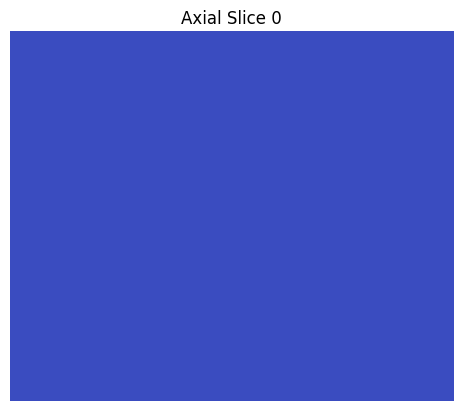

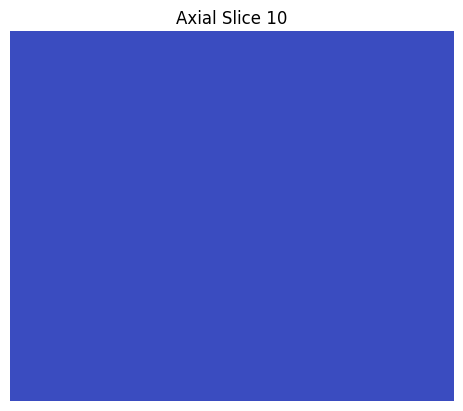

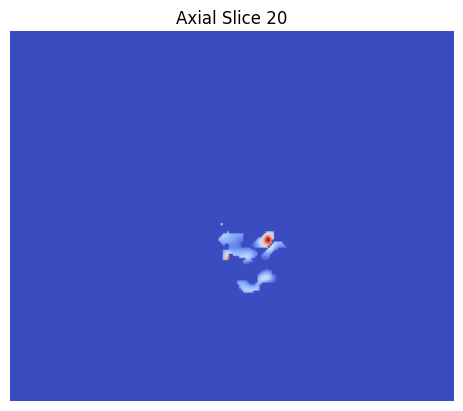

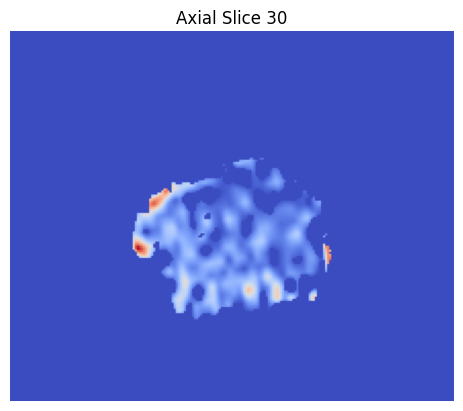

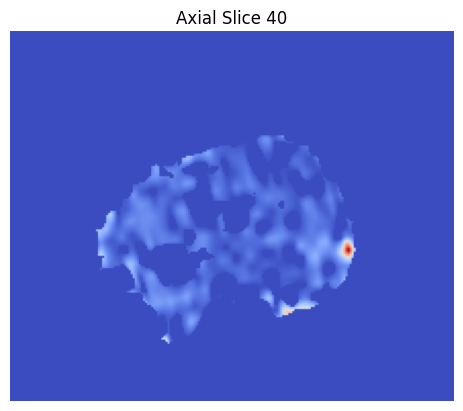

...

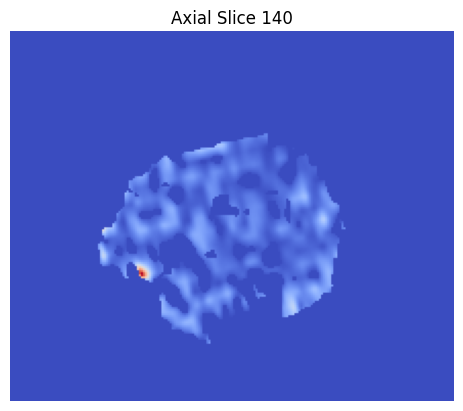

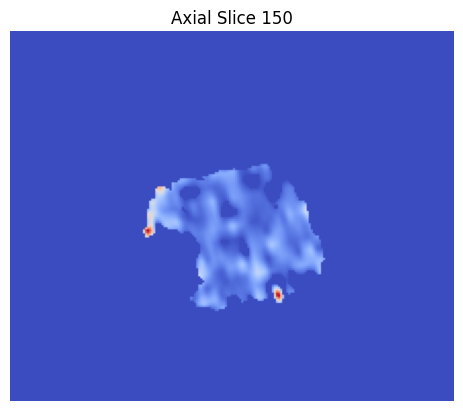

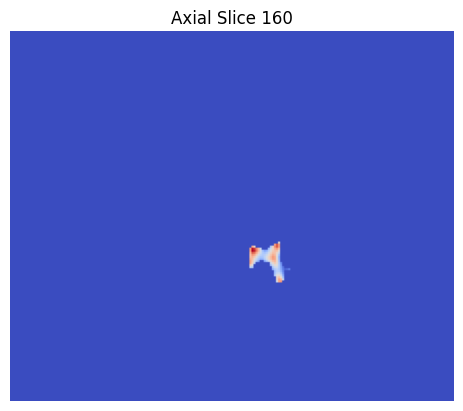

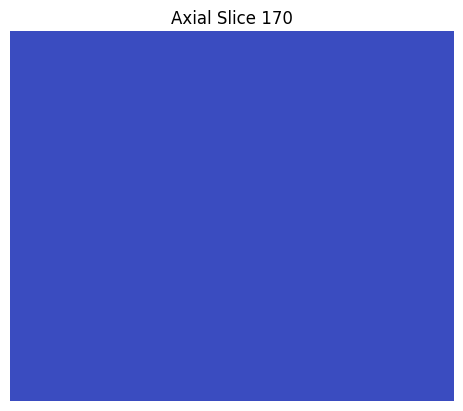

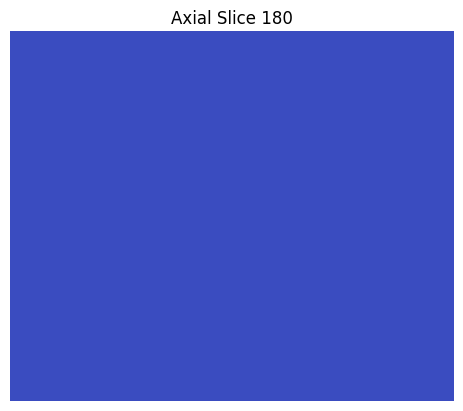

🔄 Coronal (Y-axis, front-back):


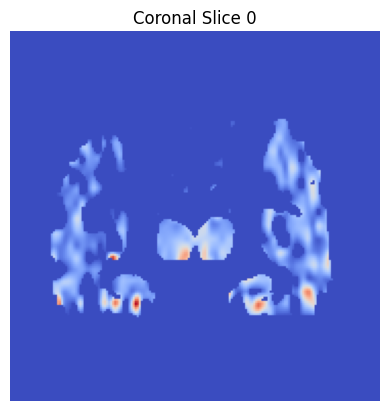

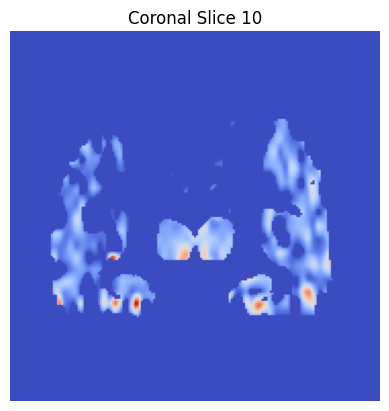

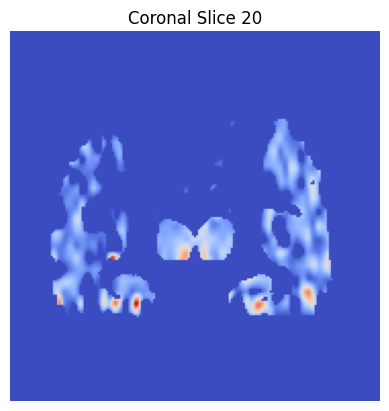

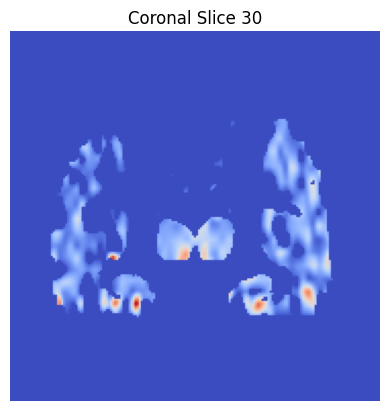

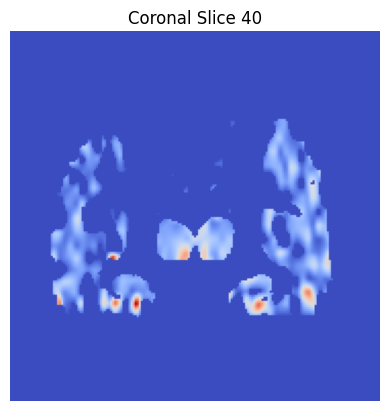

...

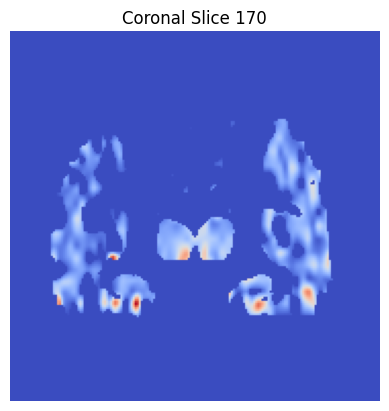

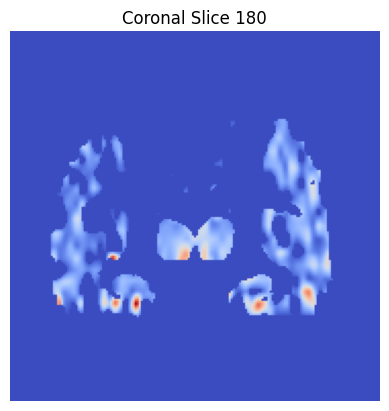

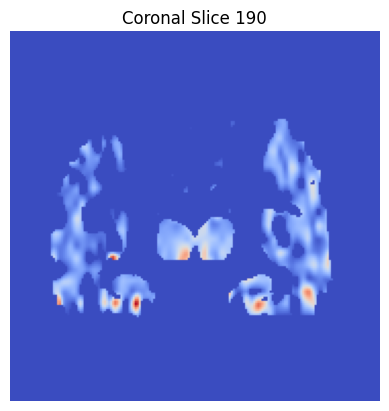

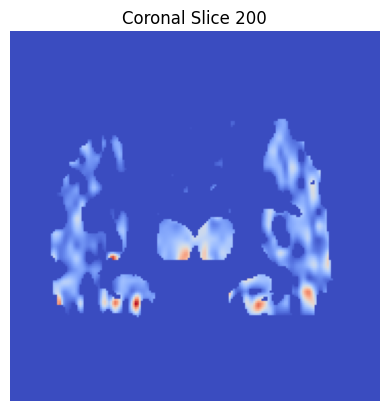

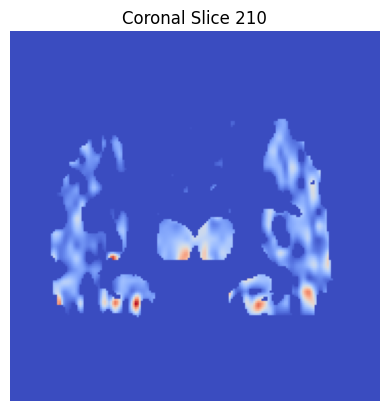

🔄 Sagittal (X-axis, left-right):


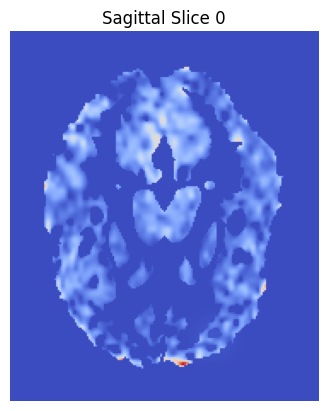

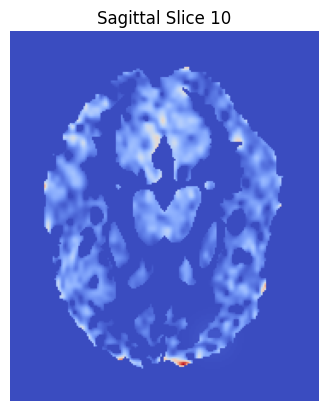

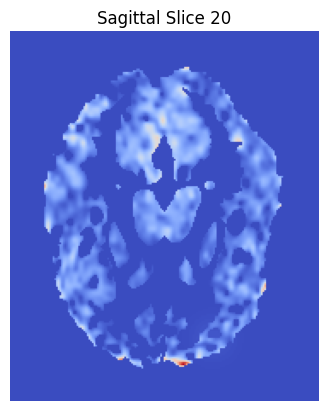

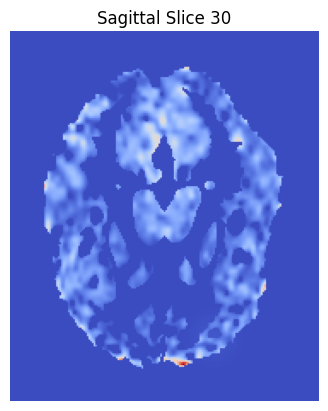

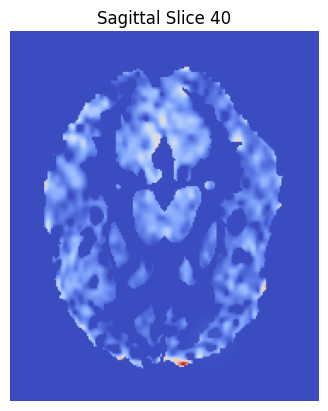

...

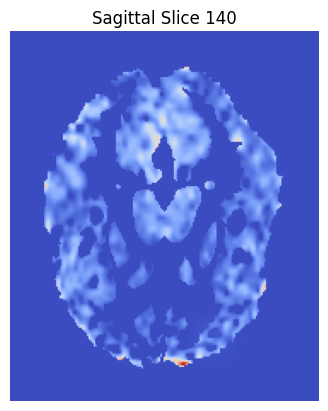

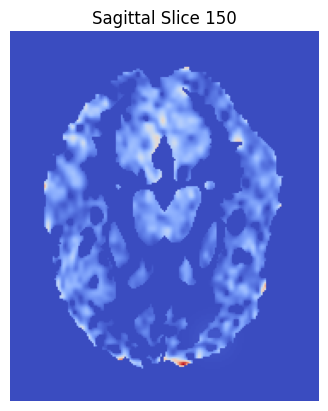

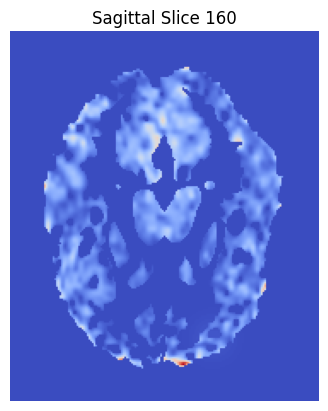

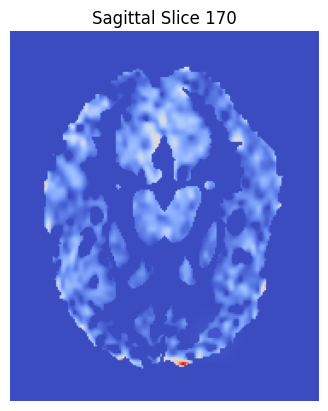

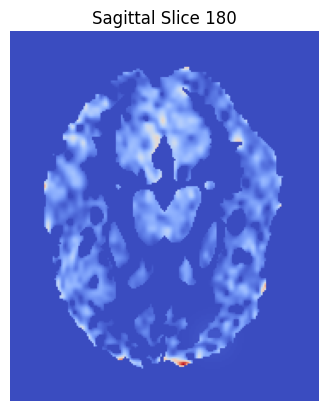

In [41]:
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt

# Load and squeeze PET volume
pet_data = nib.load('/content/pet_brain_tumor2.nii').get_fdata()
pet_data = np.squeeze(pet_data)
print("Volume shape (Z, Y, X):", pet_data.shape)

# Visualize all slices along each axis
def plot_slices(volume, axis=0, step=10, cmap='coolwarm', title_prefix=''):
    num_slices = volume.shape[axis]
    for i in range(0, num_slices, step):
        if axis == 0:
            slice_2d = volume[i, :, :]
        elif axis == 1:
            slice_2d = volume[:, 110, :]
        elif axis == 2:
            slice_2d = volume[:, :, 79]
        else:
            raise ValueError("Invalid axis")

        plt.imshow(slice_2d.T, cmap=cmap, origin='lower')
        plt.title(f"{title_prefix} Slice {i}")
        plt.axis('off')
        plt.show()

# Plot axial (Z), coronal (Y), sagittal (X)
print("🔄 Axial (Z-axis, top-down):")
plot_slices(pet_data, axis=0, step=10, title_prefix="Axial")

print("🔄 Coronal (Y-axis, front-back):")
plot_slices(pet_data, axis=1, step=10, title_prefix="Coronal")

print("🔄 Sagittal (X-axis, left-right):")
plot_slices(pet_data, axis=2, step=10, title_prefix="Sagittal")



In [39]:
import plotly.graph_objects as go
import ants
import numpy as np


img = ants.image_read("/content/pet_brain_tumor2_compressed.nii.gz")
img_np = img.numpy()
##img_np = img.numpy()
# Squeeze if image is 4D
if img_np.ndim == 4:
    img_np = img_np.squeeze()

# Normalize
img_np = (img_np - img_np.min()) / (img_np.max() - img_np.min() + 1e-8)

# Get shape
x = np.arange(img_np.shape[0])
y = np.arange(img_np.shape[1])
z = np.arange(img_np.shape[2])
X, Y, Z = np.meshgrid(x, y, z, indexing='ij')

# Create volume figure
fig = go.Figure(data=go.Volume(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value=img_np.flatten(),
    opacity=0.1,
    surface_count=20,
    colorscale='Inferno',
    caps=dict(x_show=False, y_show=False, z_show=False)
))

fig.update_layout(title="3D Medical Volume", width=700, height=700)

# 🔥 Save to file and manually open it
fig.write_html("volume1_plot.html")
print("✅ Plot saved as 'volume1plot.html'. Please open it in your browser.")
fig.show()


✅ Plot saved as 'volume1plot.html'. Please open it in your browser.
